In [1]:
import keras
import tensorflow as tf
import gdal
import os
import matplotlib.pyplot as plt
import numpy as np
from pathlib import Path
from keras_unet.models import custom_unet, satellite_unet
from keras_unet.metrics import iou, iou_thresholded
from keras_unet.losses import jaccard_distance
from keras_unet.utils import plot_segm_history

2023-07-07 10:08:23.603642: I tensorflow/core/util/port.cc:110] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2023-07-07 10:08:23.605827: I tensorflow/tsl/cuda/cudart_stub.cc:28] Could not find cuda drivers on your machine, GPU will not be used.
2023-07-07 10:08:23.641486: I tensorflow/tsl/cuda/cudart_stub.cc:28] Could not find cuda drivers on your machine, GPU will not be used.
2023-07-07 10:08:23.642196: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F AVX512_VNNI FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-07-07 10:08:24.270380: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Co

-----------------------------------------
keras-unet init: TF version is >= 2.0.0 - using `tf.keras` instead of `Keras`
-----------------------------------------


In [2]:
base_dir = Path(r'/media/studentuser/Seagate Portable Drive/training')
mask_dir = base_dir.joinpath('masks_img')
image_dir = base_dir.joinpath('img')
water_dir = mask_dir.joinpath('water_img')
shrubs_dir = mask_dir.joinpath('shrubs_img')
poly_dir = mask_dir.joinpath('polygonal_img')
trees_dir = mask_dir.joinpath('trees_img')

In [3]:
def make_path(img_dir, prefix, number):
    return os.path.join(img_dir, f"{prefix}_{number}.tif")

In [4]:
def img_number(fpath: str) -> int:
    return int(os.path.splitext(os.path.split(fpath)[1])[0].split('_')[-1])

In [5]:
def load_image(path: str) -> np.ndarray:
    ds = gdal.Open(path, gdal.GA_ReadOnly)
    return ds.GetRasterBand(1).ReadAsArray()

In [6]:
def load_stack(shape, dtype, img_dir, prefix):
    stack = np.zeros(shape = shape, dtype = dtype)
    for i in range(shape[0]):
        image_path = make_path(img_dir, prefix, i + 1)
        stack[i, :, :] = load_image(image_path)
    return stack

def load_stack_safely(shape, dtype, img_dir, prefix):
    stack = np.zeros(shape = shape, dtype = dtype)
    for i in range(shape[0]):
        image_path = make_path(img_dir, prefix, i + 1)
        if not os.path.isfile(image_path):
            print("skipping", image_path)
            continue
        stack[i, :, :] = load_image(image_path)
    return stack

In [7]:
I = 200
N = 256
M = 256
train_images = load_stack((I, N, M), np.float32, image_dir, "img")

In [34]:
train_images_R = train_images.reshape(I, N, M, 1)

In [35]:
train_images_R.shape

(200, 256, 256, 1)

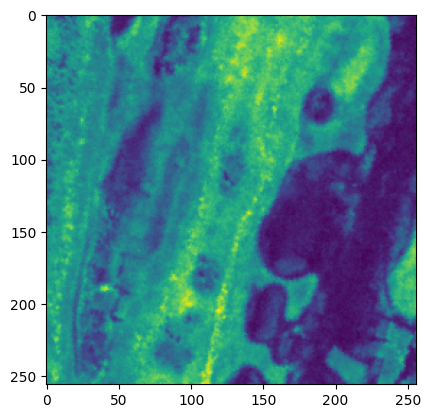

In [8]:
plt.imshow(train_images[2, :,:])

In [13]:
water_mask = load_stack_safely((I, N, M), np.int8, water_dir, "water")
poly_mask = load_stack_safely((I, N, M), np.int8, poly_dir, "polygonal")
trees_mask = load_stack_safely((I, N, M), np.int8, trees_dir, "tree")
shrubs_mask = load_stack_safely((I, N, M), np.int8, shrubs_dir, "shrub")

skipping /media/studentuser/Seagate Portable Drive/training/masks_img/water_img/water_2.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/water_img/water_7.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/water_img/water_10.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/water_img/water_13.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/water_img/water_15.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/water_img/water_22.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/water_img/water_23.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/water_img/water_24.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/water_img/water_35.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/water_img/water_36.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/wa

skipping /media/studentuser/Seagate Portable Drive/training/masks_img/polygonal_img/polygonal_82.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/polygonal_img/polygonal_83.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/polygonal_img/polygonal_84.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/polygonal_img/polygonal_85.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/polygonal_img/polygonal_86.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/polygonal_img/polygonal_87.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/polygonal_img/polygonal_90.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/polygonal_img/polygonal_92.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/polygonal_img/polygonal_94.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/polygonal_img/polygon

skipping /media/studentuser/Seagate Portable Drive/training/masks_img/shrubs_img/shrub_135.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/shrubs_img/shrub_145.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/shrubs_img/shrub_146.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/shrubs_img/shrub_152.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/shrubs_img/shrub_154.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/shrubs_img/shrub_163.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/shrubs_img/shrub_174.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/shrubs_img/shrub_175.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/shrubs_img/shrub_177.tif
skipping /media/studentuser/Seagate Portable Drive/training/masks_img/shrubs_img/shrub_179.tif
skipping /media/studentuser/Seagate Portable Drive

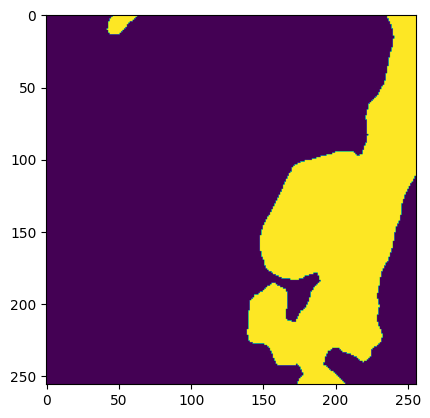

In [10]:
plt.imshow(water_mask[2, :,:])

In [44]:
model = satellite_unet((N, M, 1), 4)

In [45]:
model.compile(
    optimizer = tf.keras.optimizers.Adam(),
    loss = "binary_crossentropy",
    metrics = [iou, iou_thresholded],
)

In [46]:
# Image 13 held out due to low image quality from smoke

W = 159
Y = np.zeros(shape=(W, N, M, 4), dtype =np.int8)
Y_train_img = np.zeros(shape=(W, N, M, 1), dtype =np.float32)

Y[0:12, :, :, 0] = trees_mask[0:12, :, :]
Y[0:12, :, :, 1] = poly_mask[0:12, :, :]
Y[0:12, :, :, 2] = water_mask[0:12, :, :]
Y[0:12, :, :, 3] = shrubs_mask[0:12, :, :]
Y_train_img[0:12, :, :, 0] = train_images_R[0:12, :, :, 0]

Y[12:W, :, :, 0] = trees_mask[13:W+1, :, :]
Y[12:W, :, :, 1] = poly_mask[13:W+1, :, :]
Y[12:W, :, :, 2] = water_mask[13:W+1, :, :]
Y[12:W, :, :, 3] = shrubs_mask[13:W+1, :, :]
Y_train_img[12:W, :, :, 0] = train_images_R[13:W+1, :, :, 0]

In [47]:
# Image 175 held out due to low image quality from smoke

K = 39
Y_valid = np.zeros(shape=(K, N, M, 4), dtype =np.int8)
Y_valid_img = np.zeros(shape=(K, N, M, 1), dtype =np.float32)

Y_valid[0:14, :, :, 0] = trees_mask[160:174, :, :]
Y_valid[0:14, :, :, 1] = poly_mask[160:174, :, :]
Y_valid[0:14, :, :, 2] = water_mask[160:174, :, :]
Y_valid[0:14, :, :, 3] = shrubs_mask[160:174, :, :]
Y_valid_img[0:14, :, :, 0] = train_images_R[160:174, :, :, 0]

Y_valid[14:K, :, :, 0] = trees_mask[175:200, :, :]
Y_valid[14:K, :, :, 1] = poly_mask[175:200, :, :]
Y_valid[14:K, :, :, 2] = water_mask[175:200, :, :]
Y_valid[14:K, :, :, 3] = shrubs_mask[175:200, :, :]
Y_valid_img[14:K, :, :, 0] = train_images_R[175:200, :, :, 0]

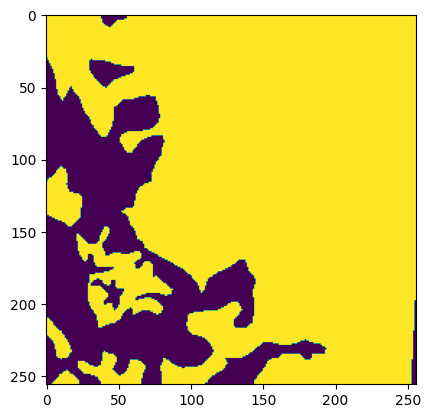

In [27]:
plt.imshow(Y[11,:, :,2])

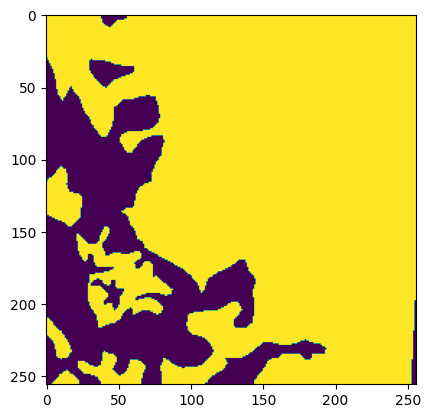

In [28]:
plt.imshow(water_mask[11,:, :])

In [42]:
Y_valid_img.shape

(39, 256, 256, 1)

In [32]:
Y.shape

(159, 256, 256, 4)

In [48]:
history = model.fit(Y_train_img, Y, epochs = 150)

Epoch 1/150
5/5 [==============================] - 27s 4s/step - loss: 0.8343 - iou: 0.1616 - iou_thresholded: 0.1914
Epoch 2/150
5/5 [==============================] - 21s 4s/step - loss: 0.4372 - iou: 0.2094 - iou_thresholded: 0.3042
Epoch 3/150
5/5 [==============================] - 21s 4s/step - loss: 0.3346 - iou: 0.2325 - iou_thresholded: 0.2924
Epoch 4/150
5/5 [==============================] - 21s 4s/step - loss: 0.3196 - iou: 0.2385 - iou_thresholded: 0.2365
Epoch 5/150
5/5 [==============================] - 21s 4s/step - loss: 0.3109 - iou: 0.2601 - iou_thresholded: 0.2903
Epoch 6/150
5/5 [==============================] - 21s 4s/step - loss: 0.3020 - iou: 0.2898 - iou_thresholded: 0.3676
Epoch 7/150
5/5 [==============================] - 21s 4s/step - loss: 0.2915 - iou: 0.2767 - iou_thresholded: 0.3204
Epoch 8/150
5/5 [==============================] - 21s 4s/step - loss: 0.2725 - iou: 0.3006 - iou_thresholded: 0.3520
Epoch 9/150
5/5 [==============================] - 20s 4

5/5 [==============================] - 20s 4s/step - loss: 0.1861 - iou: 0.4587 - iou_thresholded: 0.5494
Epoch 70/150
5/5 [==============================] - 21s 4s/step - loss: 0.1840 - iou: 0.4741 - iou_thresholded: 0.5724
Epoch 71/150
5/5 [==============================] - 20s 4s/step - loss: 0.1830 - iou: 0.4766 - iou_thresholded: 0.5661
Epoch 72/150
5/5 [==============================] - 20s 4s/step - loss: 0.1848 - iou: 0.4707 - iou_thresholded: 0.5778
Epoch 73/150
5/5 [==============================] - 20s 4s/step - loss: 0.1704 - iou: 0.4934 - iou_thresholded: 0.5959
Epoch 74/150
5/5 [==============================] - 20s 4s/step - loss: 0.1811 - iou: 0.4949 - iou_thresholded: 0.5906
Epoch 75/150
5/5 [==============================] - 20s 4s/step - loss: 0.1762 - iou: 0.4978 - iou_thresholded: 0.5909
Epoch 76/150
5/5 [==============================] - 20s 4s/step - loss: 0.1842 - iou: 0.4860 - iou_thresholded: 0.5893
Epoch 77/150
5/5 [==============================] - 20s 4s/st

5/5 [==============================] - 20s 4s/step - loss: 0.1218 - iou: 0.6220 - iou_thresholded: 0.7074
Epoch 138/150
5/5 [==============================] - 20s 4s/step - loss: 0.1065 - iou: 0.6428 - iou_thresholded: 0.7453
Epoch 139/150
5/5 [==============================] - 20s 4s/step - loss: 0.1017 - iou: 0.6705 - iou_thresholded: 0.7680
Epoch 140/150
5/5 [==============================] - 20s 4s/step - loss: 0.1407 - iou: 0.6129 - iou_thresholded: 0.6815
Epoch 141/150
5/5 [==============================] - 20s 4s/step - loss: 0.1253 - iou: 0.6359 - iou_thresholded: 0.7130
Epoch 142/150
5/5 [==============================] - 20s 4s/step - loss: 0.1077 - iou: 0.6442 - iou_thresholded: 0.7462
Epoch 143/150
5/5 [==============================] - 20s 4s/step - loss: 0.1044 - iou: 0.6522 - iou_thresholded: 0.7592
Epoch 144/150
5/5 [==============================] - 20s 4s/step - loss: 0.1129 - iou: 0.6413 - iou_thresholded: 0.7363
Epoch 145/150
5/5 [==============================] - 2

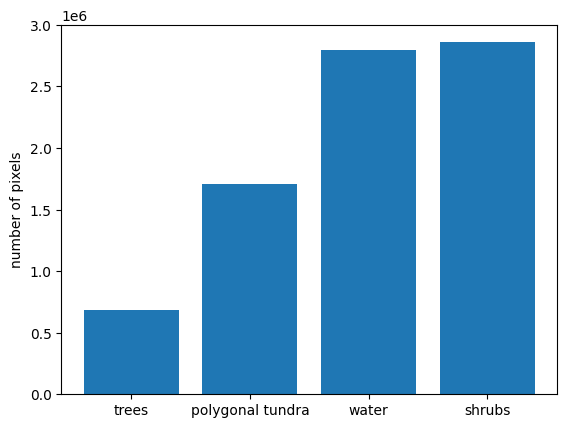

In [49]:
fig, ax = plt.subplots()
ax.bar(range(4), [trees_mask.sum(), poly_mask.sum(), water_mask.sum(), shrubs_mask.sum()])
ax.set_xticks((0, 1, 2, 3))
ax.set_xticklabels(('trees', 'polygonal tundra', 'water', 'shrubs'))
plt.ylabel('number of pixels')
plt.show()

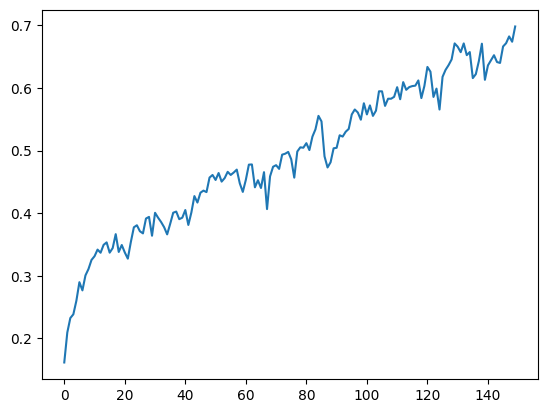

In [50]:
plt.plot(history.history['iou'])

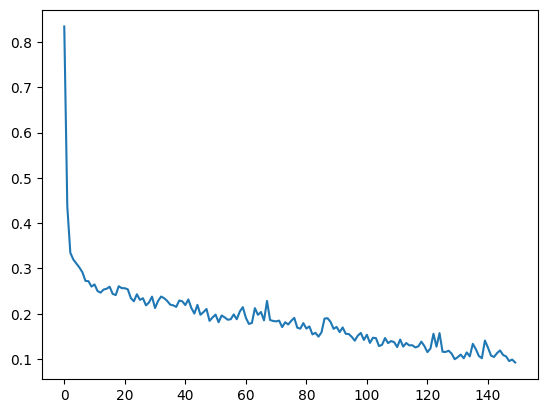

In [51]:
plt.plot(history.history['loss'])

In [52]:
Y_pred = model.predict(Y_train_img)

5/5 [==============================] - 8s 2s/step


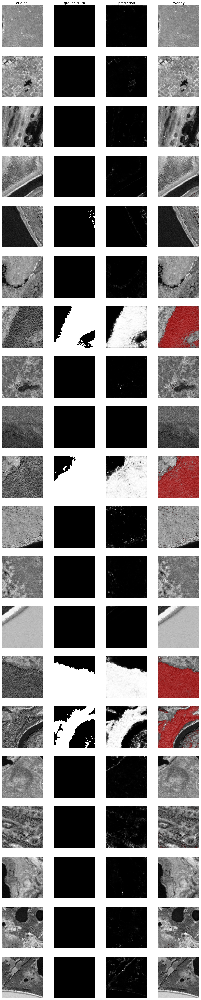

In [53]:
from keras_unet.utils import plot_imgs

# Trees
plot_imgs(
    org_imgs=Y_train_img, 
    mask_imgs=Y[:, :, :, 0], 
    pred_imgs=Y_pred[:, :, :, 0], 
    nm_img_to_plot=20
  )

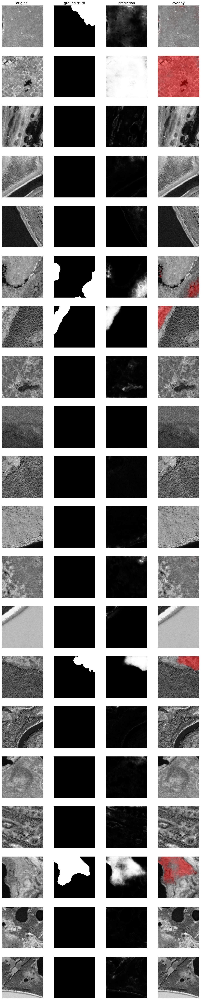

In [54]:
# Polygonal Tundra
plot_imgs(
    org_imgs=Y_train_img, 
    mask_imgs=Y[:, :, :, 1], 
    pred_imgs=Y_pred[:, :, :, 1], 
    nm_img_to_plot=20
  )

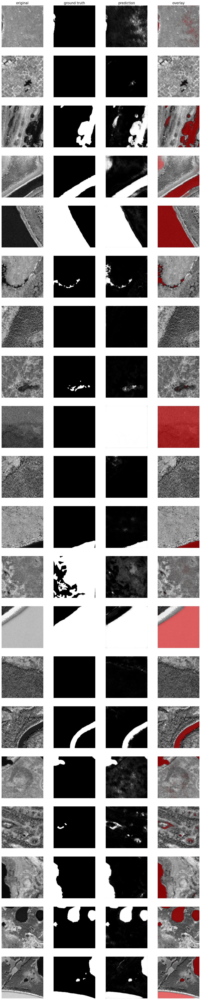

In [55]:
# Water
plot_imgs(
    org_imgs=Y_train_img, 
    mask_imgs=Y[:, :, :, 2], 
    pred_imgs=Y_pred[:, :, :, 2], 
    nm_img_to_plot=20
  )

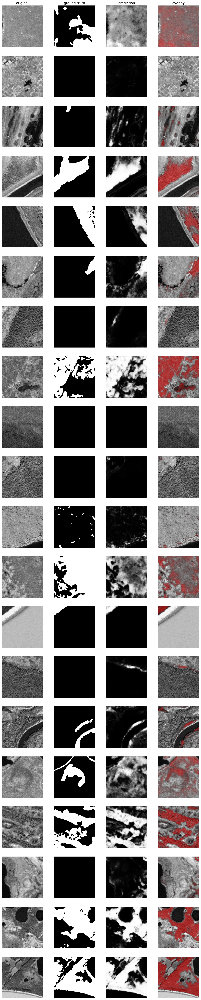

In [56]:
# Shrubs
plot_imgs(
    org_imgs=Y_train_img, 
    mask_imgs=Y[:, :, :, 3], 
    pred_imgs=Y_pred[:, :, :, 3], 
    nm_img_to_plot=20
  )

In [57]:
valid_pred = model.predict(Y_valid_img)

2/2 [==============================] - 2s 527ms/step


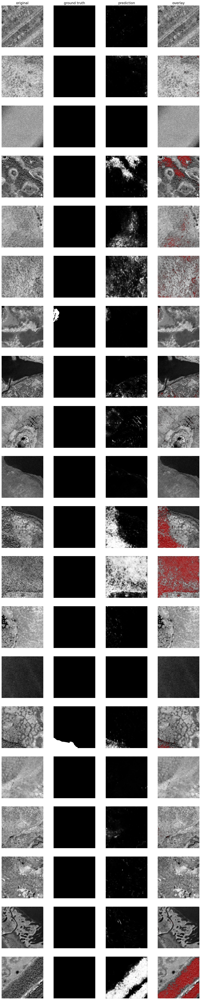

In [58]:
# Trees
plot_imgs(
    org_imgs=Y_valid_img, 
    mask_imgs=Y_valid[:, :, :, 0], 
    pred_imgs=valid_pred[:, :, :, 0], 
    nm_img_to_plot=20
  )

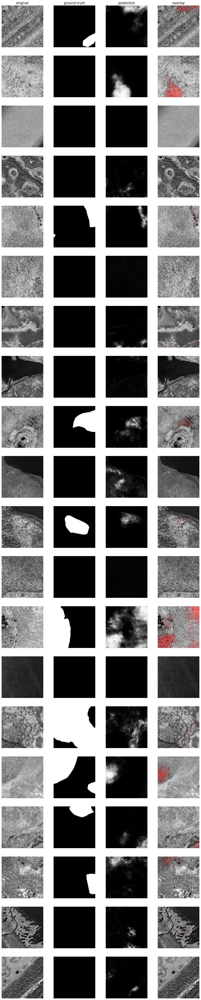

In [59]:
# Polygonal Tundra
plot_imgs(
    org_imgs=Y_valid_img, 
    mask_imgs=Y_valid[:, :, :, 1], 
    pred_imgs=valid_pred[:, :, :, 1], 
    nm_img_to_plot=20
  )

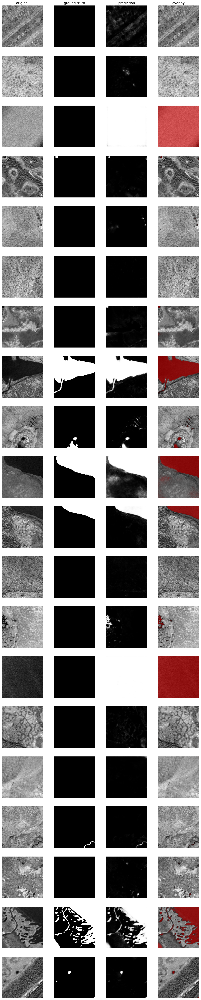

In [60]:
# Water
plot_imgs(
    org_imgs=Y_valid_img, 
    mask_imgs=Y_valid[:, :, :, 2], 
    pred_imgs=valid_pred[:, :, :, 2], 
    nm_img_to_plot=20
  )

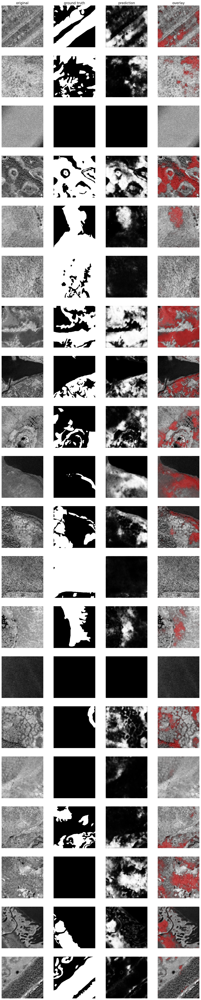

In [61]:
# Shrubs
plot_imgs(
    org_imgs=Y_valid_img, 
    mask_imgs=Y_valid[:, :, :, 3], 
    pred_imgs=valid_pred[:, :, :, 3], 
    nm_img_to_plot=20
  )